In [1]:
import scanpy as sc
import numpy as np
import scanpy.external as sce
import pandas as pd
import scvelo as scv
import seaborn as sns
import matplotlib.pyplot as plt
import importlib
import sys
import symphonypy as sp

sys.path.append("/home/sergey/tools/sclitr/")
import sclitr as sl

# Figures aesthetics
sc.set_figure_params(dpi=150)

# Pathes
DATA_PATH = "/home/sergey/data/clonal_project"
HOME_PATH = "/home/sergey/projects/clonal_project"

# Additional functions
exec(open(f"{HOME_PATH}/tools/tools.py").read())
sns.set_style("ticks")

import matplotlib

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

sc.set_figure_params(dpi=150, dpi_save=300)
sns.set_style("ticks")

In [18]:
adata_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_E13_clonal_clusters.h5ad")
adata_face = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_E13_clonal_clusters.h5ad")

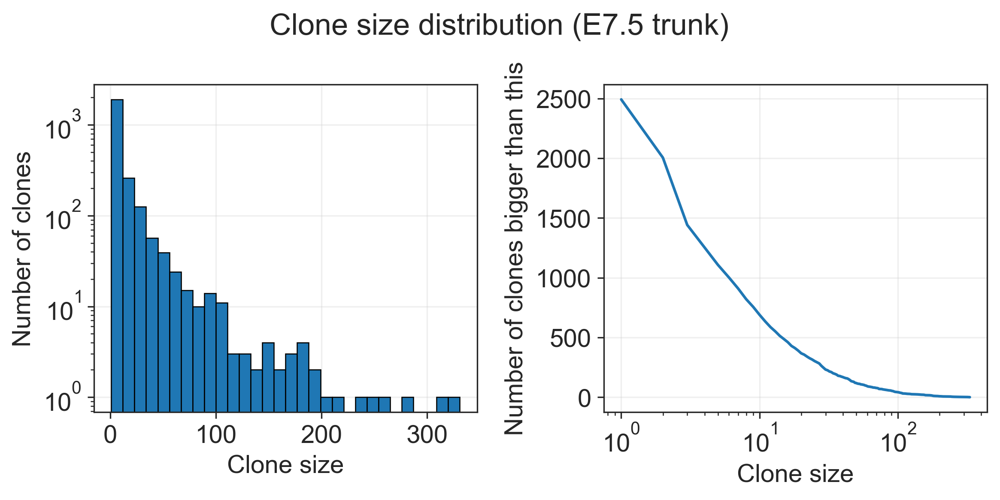

In [24]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sns.histplot(
    adata_trunk.obs["E7.5:clones"].value_counts()[1:],
    bins=30,
    log=True,
    # log_scale=True,
    alpha=1,
    edgecolor="black",
    ax=axes[0],
)
axes[0].grid(alpha=0.3)
axes[0].set_xlabel("Clone size")
axes[0].set_ylabel("Number of clones")

size_dist = adata_trunk.obs["E7.5:clones"].value_counts()[1:].value_counts().sort_index()

sns.lineplot(np.cumsum(size_dist[::-1]), ax=axes[1])
axes[1].grid(alpha=0.3)
axes[1].set_xscale("log")
axes[1].set_xlabel("Clone size")
axes[1].set_ylabel("Number of clones bigger than this")

plt.suptitle("Clone size distribution (E7.5 trunk)")
fig.tight_layout()

plt.savefig("figures/01_Trunk_dist_7.pdf", bbox_inches="tight")

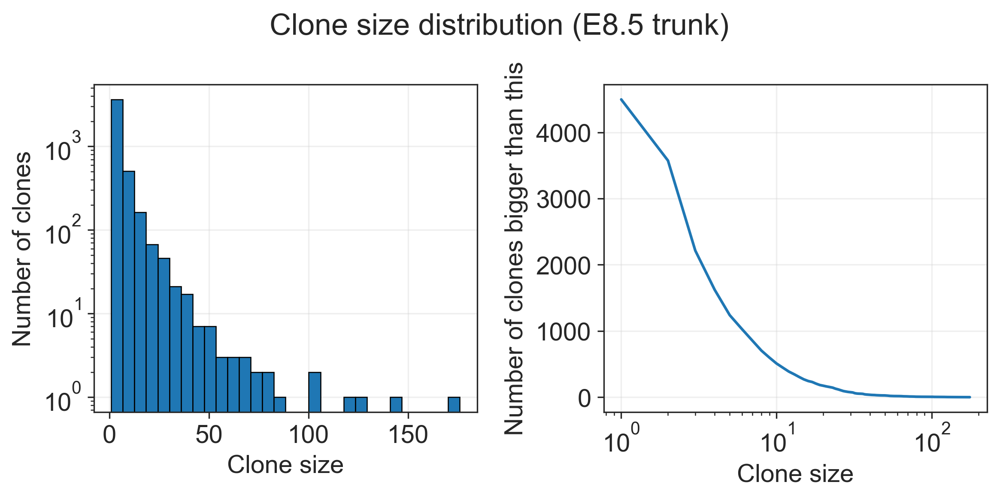

In [22]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sns.histplot(
    adata_trunk.obs["E8.5:clones"].value_counts()[1:],
    bins=30,
    log=True,
    # log_scale=True,
    alpha=1,
    edgecolor="black",
    ax=axes[0],
)
axes[0].grid(alpha=0.3)
axes[0].set_xlabel("Clone size")
axes[0].set_ylabel("Number of clones")

size_dist = adata_trunk.obs["E8.5:clones"].value_counts()[1:].value_counts().sort_index()

sns.lineplot(np.cumsum(size_dist[::-1]), ax=axes[1])
axes[1].grid(alpha=0.3)
axes[1].set_xscale("log")
axes[1].set_xlabel("Clone size")
axes[1].set_ylabel("Number of clones bigger than this")

plt.suptitle("Clone size distribution (E8.5 trunk)")
fig.tight_layout()

plt.savefig("figures/01_Trunk_dist_8.pdf", bbox_inches="tight")

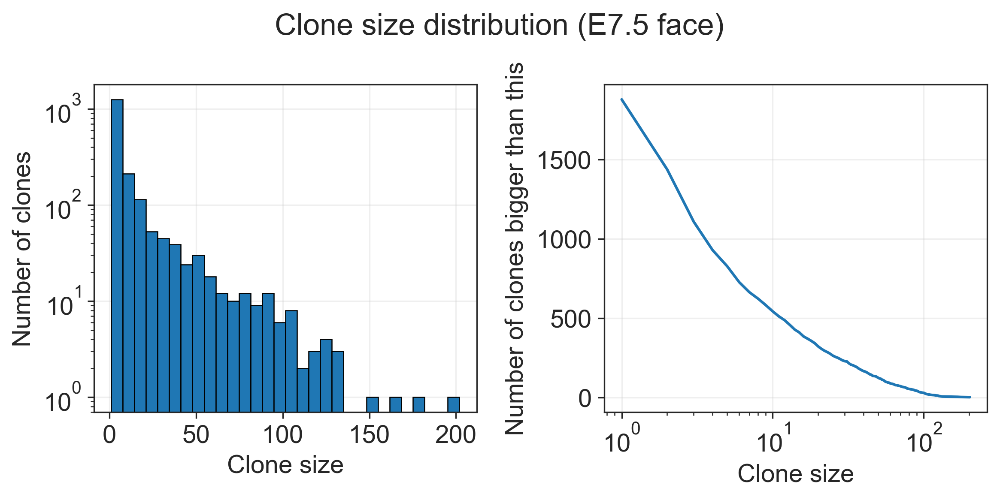

In [25]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sns.histplot(
    adata_face.obs["E7.5:clones"].value_counts()[1:],
    bins=30,
    log=True,
    # log_scale=True,
    alpha=1,
    edgecolor="black",
    ax=axes[0],
)
axes[0].grid(alpha=0.3)
axes[0].set_xlabel("Clone size")
axes[0].set_ylabel("Number of clones")

size_dist = adata_face.obs["E7.5:clones"].value_counts()[1:].value_counts().sort_index()

sns.lineplot(np.cumsum(size_dist[::-1]), ax=axes[1])
axes[1].grid(alpha=0.3)
axes[1].set_xscale("log")
axes[1].set_xlabel("Clone size")
axes[1].set_ylabel("Number of clones bigger than this")

plt.suptitle("Clone size distribution (E7.5 face)")
fig.tight_layout()

plt.savefig("figures/01_Face_dist_7.pdf", bbox_inches="tight")

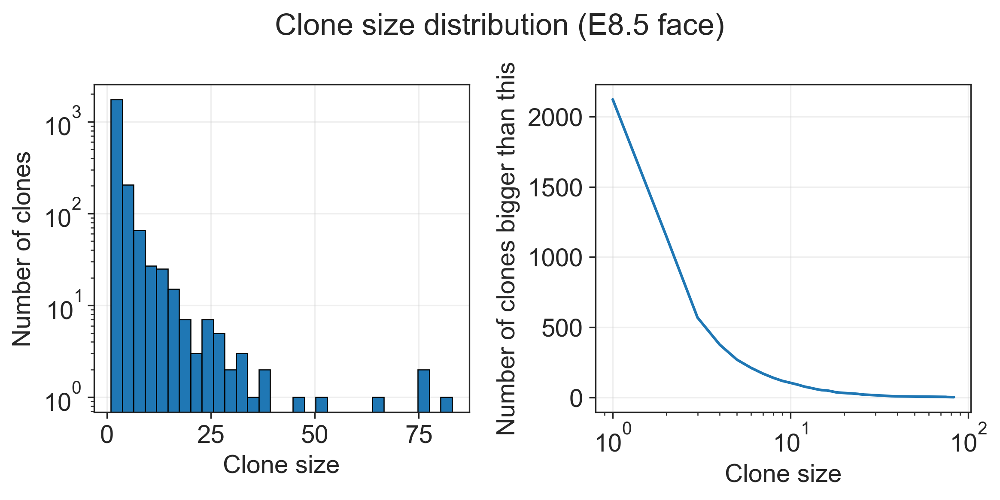

In [27]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sns.histplot(
    adata_face.obs["E8.5:clones"].value_counts()[1:],
    bins=30,
    log=True,
    # log_scale=True,
    alpha=1,
    edgecolor="black",
    ax=axes[0],
)
axes[0].grid(alpha=0.3)
axes[0].set_xlabel("Clone size")
axes[0].set_ylabel("Number of clones")

size_dist = adata_face.obs["E8.5:clones"].value_counts()[1:].value_counts().sort_index()

sns.lineplot(np.cumsum(size_dist[::-1]), ax=axes[1])
axes[1].grid(alpha=0.3)
axes[1].set_xscale("log")
axes[1].set_xlabel("Clone size")
axes[1].set_ylabel("Number of clones bigger than this")

plt.suptitle("Clone size distribution (E8.5 face)")
fig.tight_layout()

plt.savefig("figures/01_Face_dist_8.pdf", bbox_inches="tight")

In [37]:
print("""
Trunk (control)

Total cells:	108268

Number of cells in E7 cells in informative (> 2 cell) clones:	29350 (27.11%)
Number of E7 informative (> 2 cell) clones:	2005

Number of cells in E8 cells in informative (> 2 cell) clones:	21401 (19.77%)
Number of E8 informative (> 2 cell) clones:	3573

Number of cells in both E7 and E8 informative clones:	1267 (1.17%)
Number of cells in any informative clones (E7 + E8 - E7E8):	49484 (45.71%)

Consistency score (for double barcoded cells: mean fraction of E8 clone inside the biggest E7 parental clone):	0.9656036232785615
""")


Trunk (control)

Total cells:	108268

Number of cells in E7 cells in informative (> 2 cell) clones:	29350 (27.11%)
Number of E7 informative (> 2 cell) clones:	2005

Number of cells in E8 cells in informative (> 2 cell) clones:	21401 (19.77%)
Number of E8 informative (> 2 cell) clones:	3573

Number of cells in both E7 and E8 informative clones:	1267 (1.17%)
Number of cells in any informative clones (E7 + E8 - E7E8):	49484 (45.71%)

Consistency score (for double barcoded cells: mean fraction of E8 clone inside the biggest E7 parental clone):	0.9656036232785615



In [38]:
print("""
Face (control)

Total cells:	50457

Number of cells in E7 cells in informative (> 2 cells) clones:	22693 (44.97%)
Number of E7 informative (> 2 cells) clones:	1437

Number of cells in E8 cells in informative (> 2 cells) clones:	5239 (10.38%)
Number of E8 informative (> 2 cells) clones:	1149

Number of cells in both E7 and E8 informative clones:	284 (0.56%)
Number of cells in any informative clones (E7 + E8 - E7E8):	27648 (54.80%)

Consistency score (for double barcoded cells: mean fraction of E8 clone inside the biggest E7 parental clone):	0.9615267711012391
""")


Face (control)

Total cells:	50457

Number of cells in E7 cells in informative (> 2 cells) clones:	22693 (44.97%)
Number of E7 informative (> 2 cells) clones:	1437

Number of cells in E8 cells in informative (> 2 cells) clones:	5239 (10.38%)
Number of E8 informative (> 2 cells) clones:	1149

Number of cells in both E7 and E8 informative clones:	284 (0.56%)
Number of cells in any informative clones (E7 + E8 - E7E8):	27648 (54.80%)

Consistency score (for double barcoded cells: mean fraction of E8 clone inside the biggest E7 parental clone):	0.9615267711012391



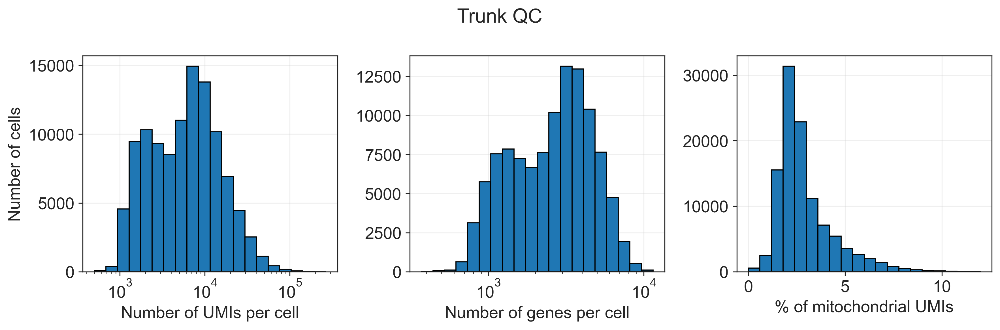

In [58]:
fig, axes = plt.subplots(ncols=3, figsize=(12, 4))

sns.histplot(adata_trunk.obs.total_counts, ax=axes[0], log_scale=True, bins=20, edgecolor="black", alpha=1)
axes[0].set_ylabel("Number of cells")
axes[0].set_xlabel("Number of UMIs per cell")
axes[0].grid(alpha=0.3)

sns.histplot(adata_trunk.obs.n_genes_by_counts, ax=axes[1], log_scale=True, bins=20, edgecolor="black", alpha=1)
axes[1].set_ylabel("")
axes[1].set_xlabel("Number of genes per cell")
axes[1].grid(alpha=0.3)

sns.histplot(adata_trunk.obs.pct_counts_mt, ax=axes[2], bins=20, edgecolor="black", alpha=1)
axes[2].set_ylabel("")
axes[2].set_xlabel("% of mitochondrial UMIs")
axes[2].grid(alpha=0.3)

fig.suptitle("Trunk QC")
fig.tight_layout()

plt.savefig("figures/01_Trunk_QC.pdf", bbox_inches="tight")

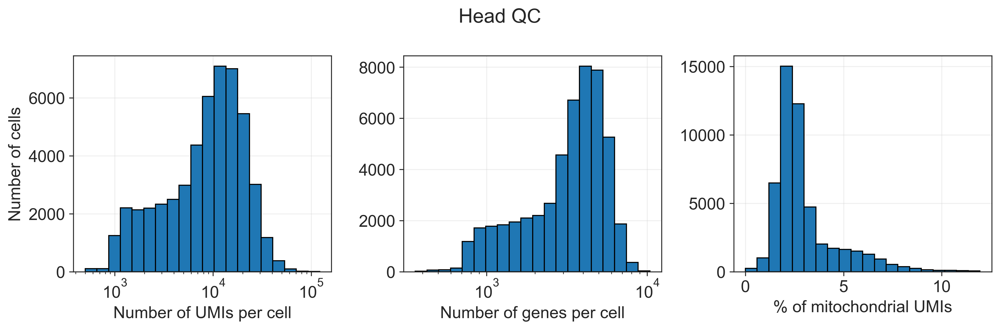

In [60]:
fig, axes = plt.subplots(ncols=3, figsize=(12, 4))

sns.histplot(adata_face.obs.total_counts, ax=axes[0], log_scale=True, bins=20, edgecolor="black", alpha=1)
axes[0].set_ylabel("Number of cells")
axes[0].set_xlabel("Number of UMIs per cell")
axes[0].grid(alpha=0.3)

sns.histplot(adata_face.obs.n_genes_by_counts, ax=axes[1], log_scale=True, bins=20, edgecolor="black", alpha=1)
axes[1].set_ylabel("")
axes[1].set_xlabel("Number of genes per cell")
axes[1].grid(alpha=0.3)

sns.histplot(adata_face.obs.pct_counts_mt, ax=axes[2], bins=20, edgecolor="black", alpha=1)
axes[2].set_ylabel("")
axes[2].set_xlabel("% of mitochondrial UMIs")
axes[2].grid(alpha=0.3)

fig.suptitle("Head QC")
fig.tight_layout()

plt.savefig("figures/01_Head_QC.pdf", bbox_inches="tight")

In [61]:
clones_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")
clones_face = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/E13_face_clonal_embedding.h5ad")

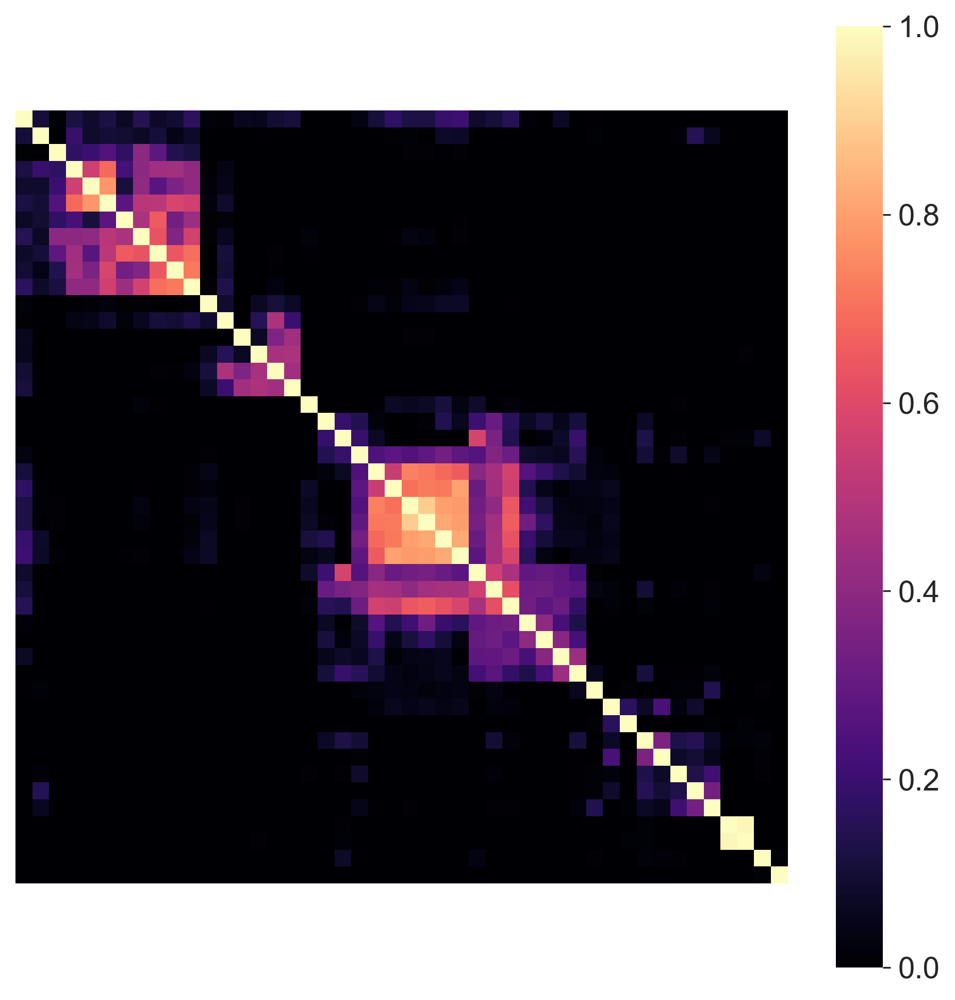

In [74]:
from scipy.cluster.hierarchy import linkage, dendrogram

fig, ax = plt.subplots(figsize=(8, 8))

data = pd.DataFrame(
    np.corrcoef(clones_trunk.X.T),
    index=list(clones_trunk.var_names),
    columns=list(clones_trunk.var_names),
)
ct_order = dendrogram(linkage(data, method="average", metric="correlation"), no_plot=True)["leaves"]
data = data[data.columns[ct_order]].loc[data.columns[ct_order]]

sns.heatmap(
    data,
    square=True,
    xticklabels=(),
    yticklabels=(),
    vmin=0,
    vmax=1,
    ax=ax,
    cmap="magma"
)

plt.savefig("figures/02_heatmap_trunk.pdf", bbox_inches="tight")

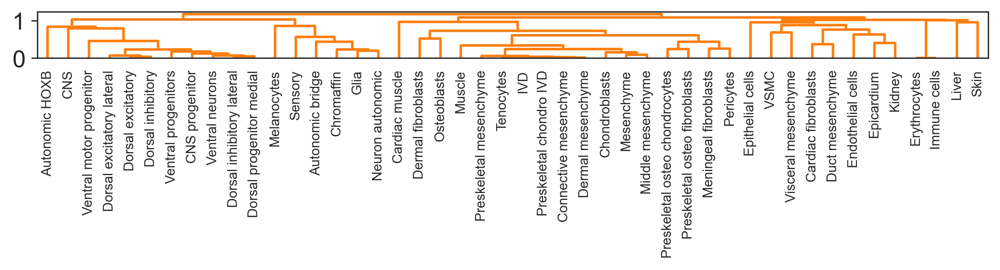

In [72]:
fig, ax = plt.subplots(figsize=(10, 0.5))
_ = dendrogram(linkage(data, method="average", metric="correlation"), color_threshold=200, ax=ax, labels=data.index)
plt.savefig("figures/02_dendro_trunk.pdf", bbox_inches="tight")

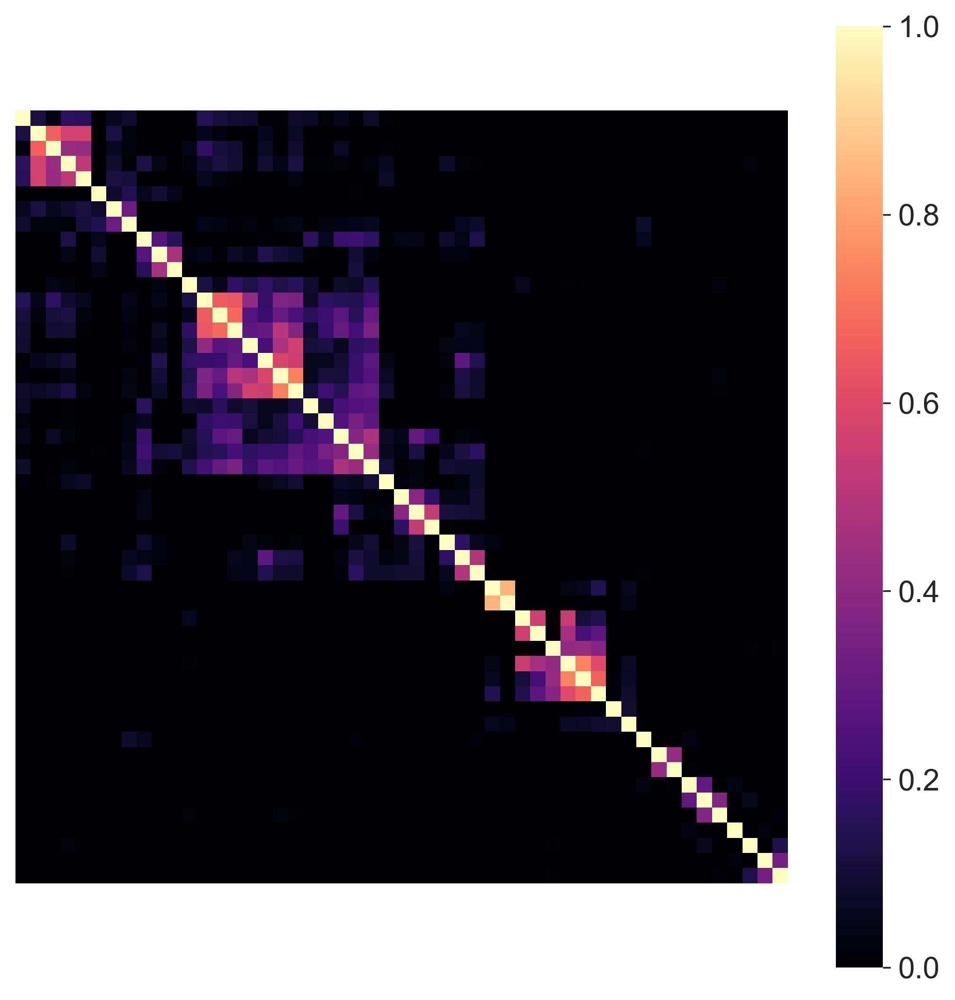

In [83]:
from scipy.cluster.hierarchy import linkage, dendrogram

fig, ax = plt.subplots(figsize=(8, 8))

data = pd.DataFrame(
    np.corrcoef(clones_face.X.T),
    index=list(clones_face.var_names),
    columns=list(clones_face.var_names),
)
data = data.iloc[1:].dropna(axis=1)
ct_order = dendrogram(linkage(data, method="average", metric="correlation"), no_plot=True)["leaves"]
data = data[data.columns[ct_order]].loc[data.columns[ct_order]]

sns.heatmap(
    data,
    square=True,
    xticklabels=(),
    yticklabels=(),
    vmin=0,
    vmax=1,
    ax=ax,
    cmap="magma"
)

plt.savefig("figures/02_heatmap_face.pdf", bbox_inches="tight")

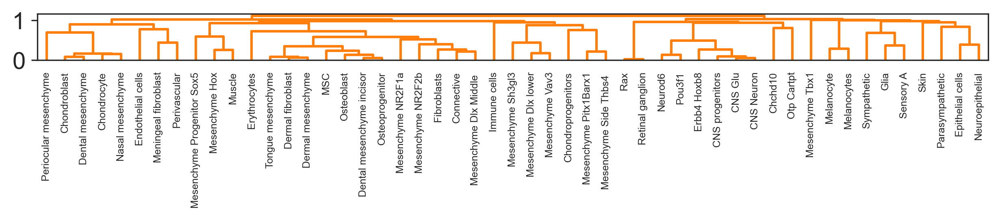

In [84]:
fig, ax = plt.subplots(figsize=(10, 0.5))
_ = dendrogram(linkage(data, method="average", metric="correlation"), color_threshold=200, ax=ax, labels=data.index)
plt.savefig("figures/02_dendro_face.pdf", bbox_inches="tight")

In [86]:
def flip_vertically(matrix):
    min_range = matrix[:, 1].min()
    max_range = matrix[:, 1].max()
    
    new_matrix = matrix.copy()
    new_matrix[:, 1] = max_range - matrix[:, 1] + min_range
    return new_matrix

In [87]:
def clear_adata(adata):
    for col in adata.obs.columns[adata.obs.columns.str.startswith("Regulon")]:
        del adata.obs[col]
    for col in adata.obs.columns[adata.obs.columns.str.startswith("Module")]:
        del adata.obs[col]
    for col in adata.var.columns[adata.var.columns.str.startswith("Regulon")]:
        del adata.var[col]
    for col in adata.var.columns[adata.var.columns.str.startswith("Module")]:
        del adata.var[col]
    del adata.layers["count"]

In [88]:
adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S2.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
clear_adata(adata)

In [103]:
adata_trunk_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_mes_E13_clonal_clusters.h5ad")

adata_trunk_mes.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_trunk_mes, groupby="celltype_l2")

In [112]:
set(adata_trunk_mes.obs.celltype_l2)

{'Cardiac fibroblasts',
 'Chondroblasts',
 'Connective mesenchyme',
 'Dermal fibroblasts',
 'Dermal mesenchyme',
 'Duct mesenchyme',
 'Epicardium',
 'IVD',
 'Kidney',
 'Meningeal fibroblasts',
 'Mesenchyme',
 'Middle mesenchyme',
 'Osteoblasts',
 'Pericytes',
 'Preskeletal chondro IVD',
 'Preskeletal mesenchyme',
 'Preskeletal osteo chondrocytes',
 'Preskeletal osteo fibroblasts',
 'Tenocytes',
 'VSMC',
 'Visceral mesenchyme'}

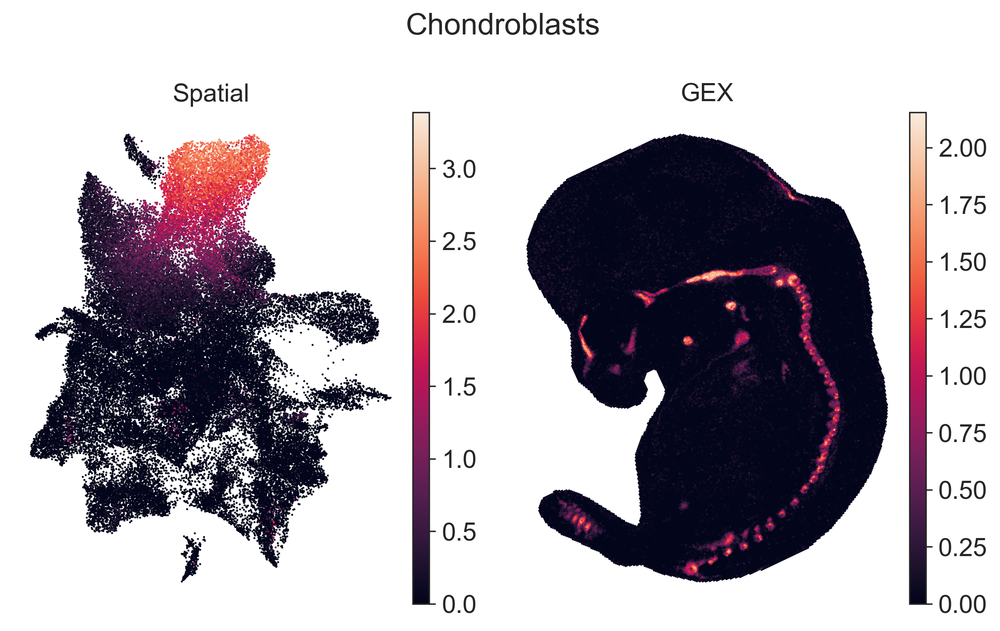

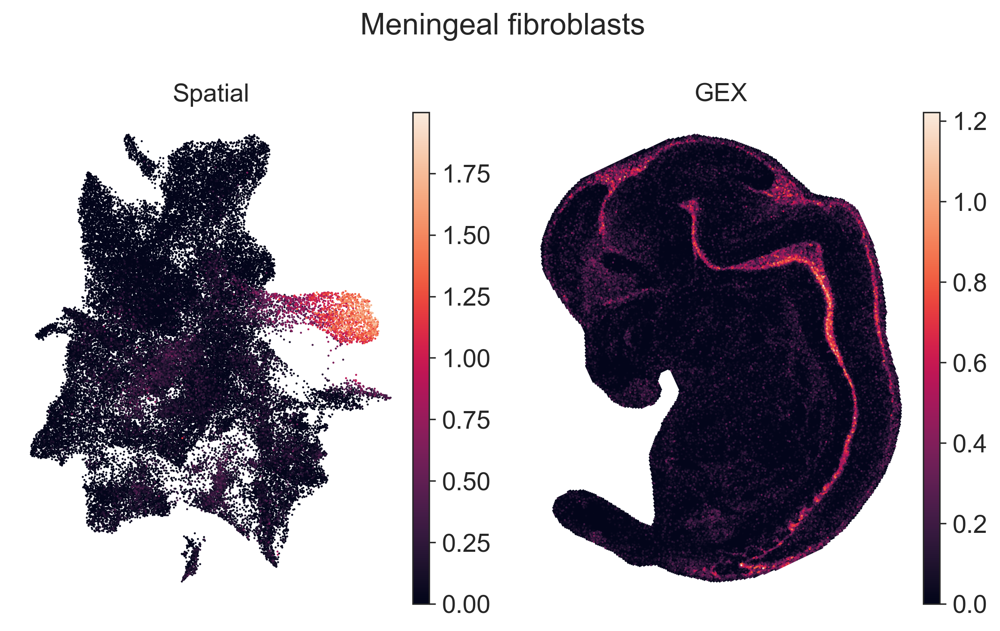

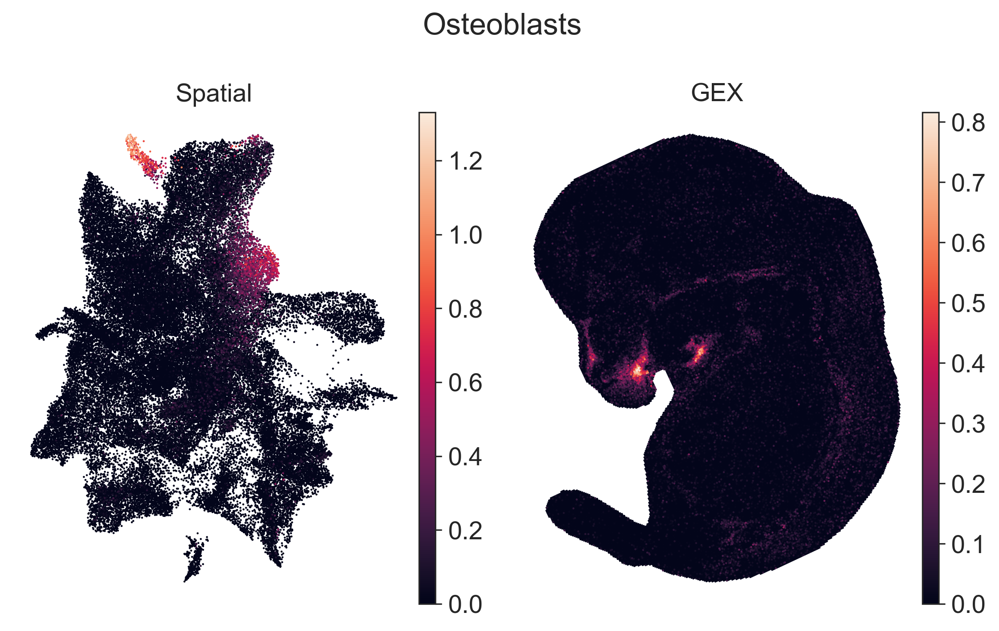

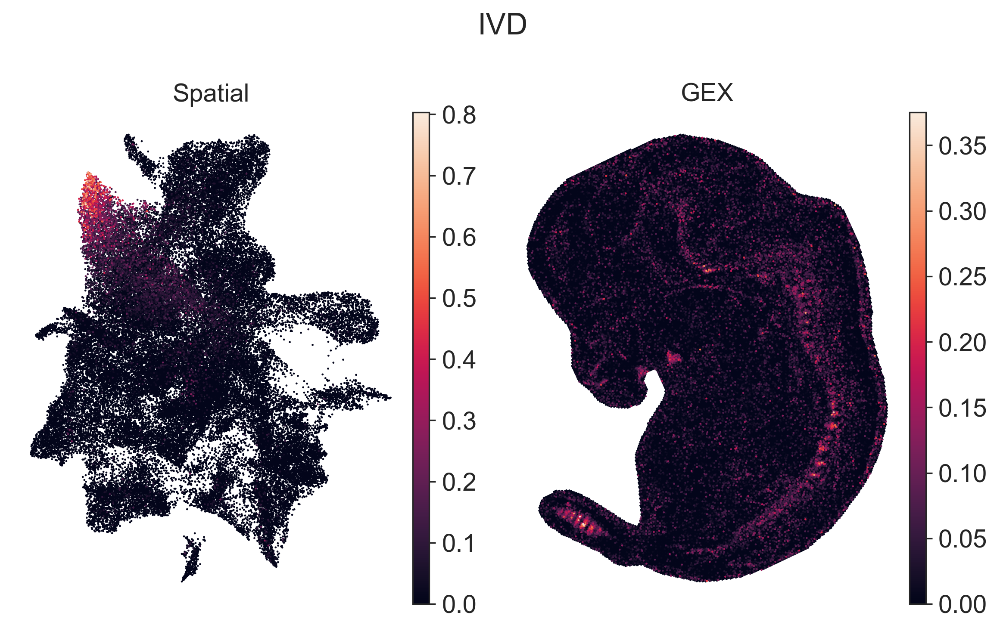

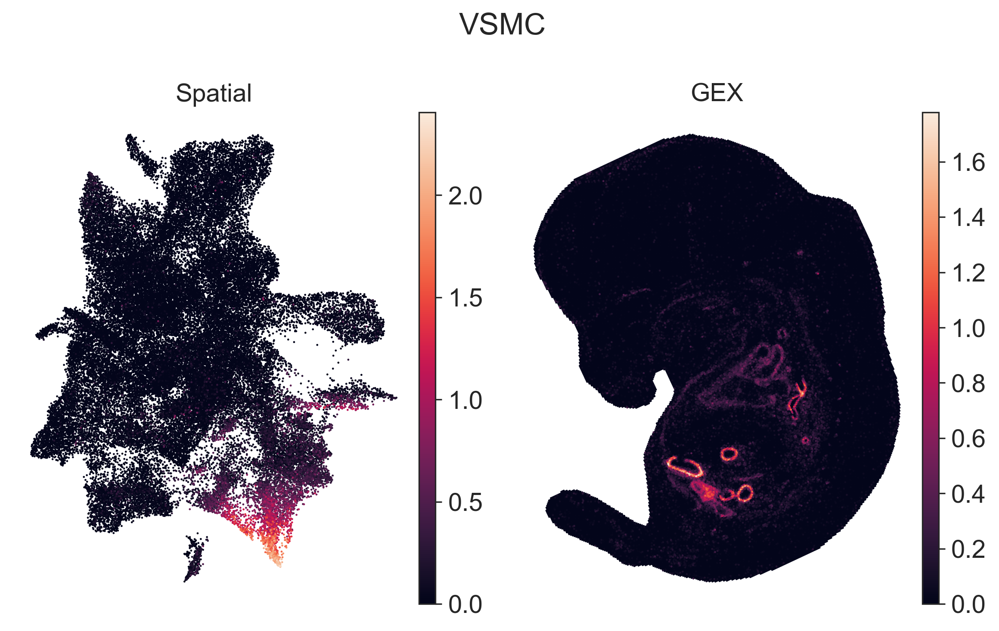

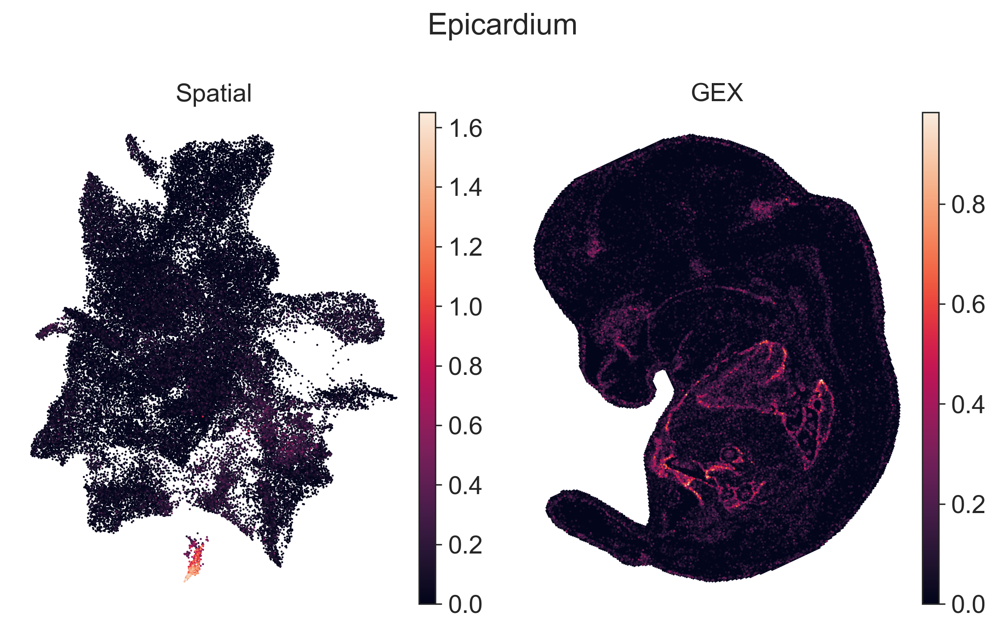

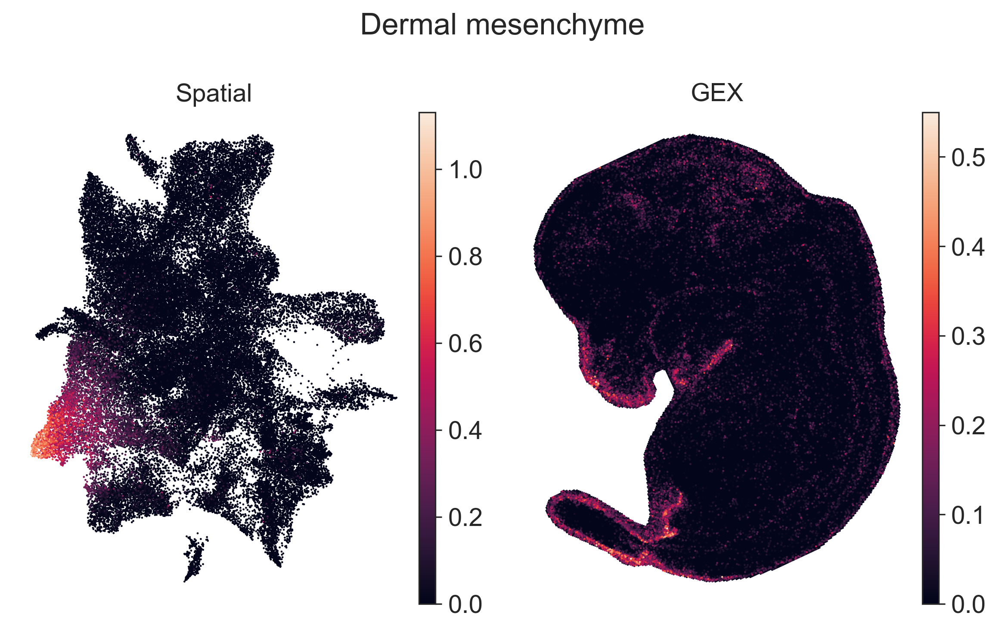

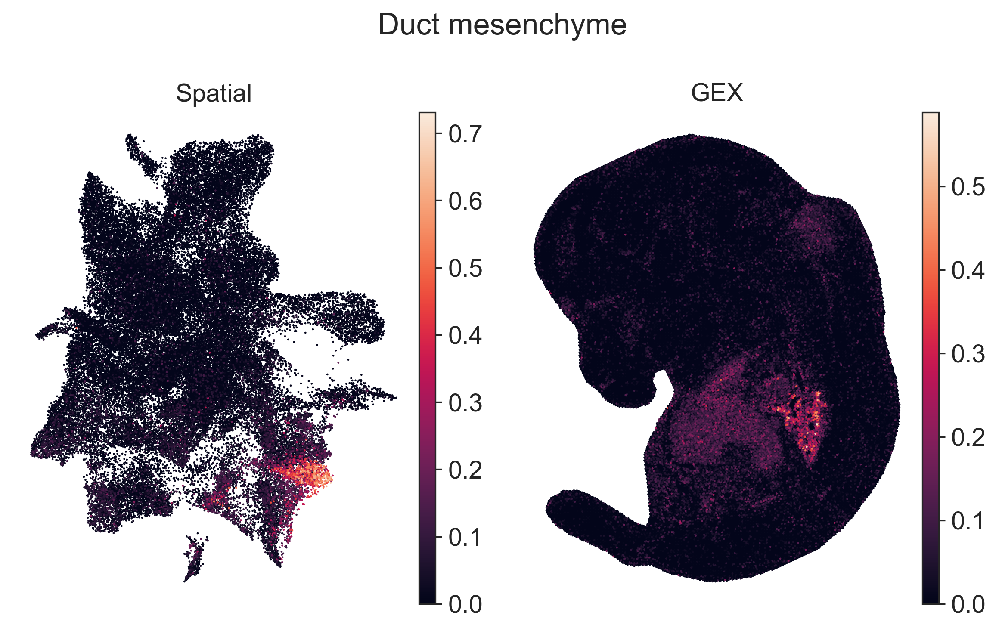

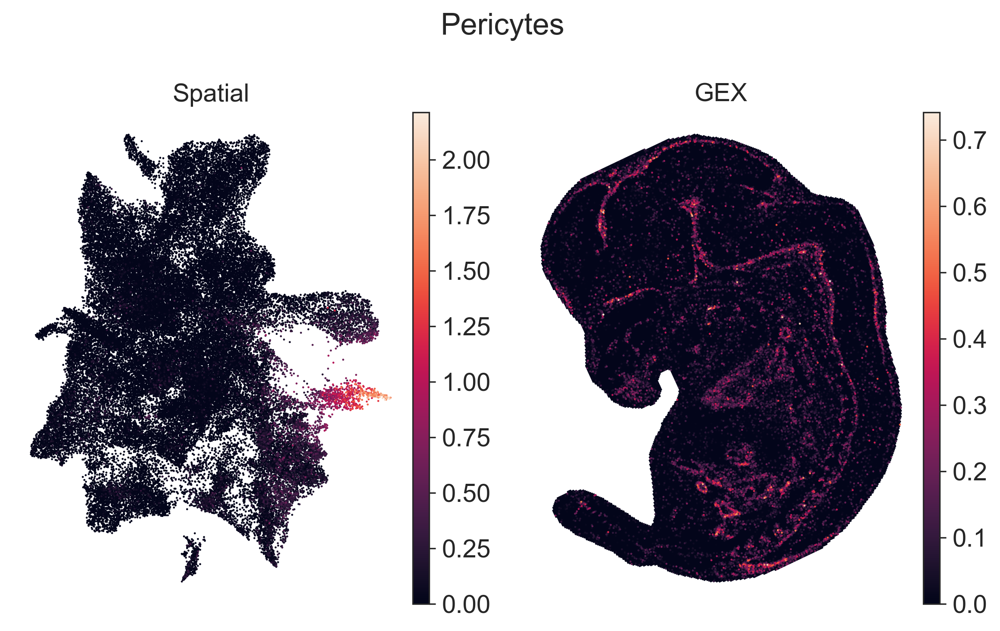

In [129]:
for ct in [
    "Chondroblasts", "Meningeal fibroblasts", "Osteoblasts", "IVD",
    "VSMC", "Epicardium", "Dermal mesenchyme", "Duct mesenchyme",
    "Pericytes"
]:
    df = sc.get.rank_genes_groups_df(adata_trunk_mes, group=ct)
    genes = df[(df.logfoldchanges > 3) & (df.pvals_adj < 1e-10)].names[:20]
    sc.tl.score_genes(adata, gene_list=genes, score_name=ct)
    sc.tl.score_genes(adata_trunk_mes, gene_list=genes, score_name=ct)
    
    fig, axes = plt.subplots(figsize=(8, 5), ncols=2)

    sc.pl.embedding(adata, color=ct, basis="spatial", ax=axes[1], s=5, show=False, vmin=0, title="GEX", frameon=False)
    sc.pl.umap(adata_trunk_mes, color=ct, ax=axes[0], s=5, show=False, vmin=0, title="Spatial", frameon=False)

    fig.suptitle(ct)
    fig.tight_layout()
    
    plt.savefig(f"figures/{ct}_spatial_validation.pdf", bbox_inches="tight")

In [134]:
clones_pert_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations_noEtOH/clone2vec/trunk_clone2vec.h5ad")
clones_pert_face = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations_noEtOH/clone2vec/face_clone2vec.h5ad")

In [173]:
mes_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations_noEtOH/clone2vec/trunk_mesenchyme_merged.h5ad")

neur_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/perturbations_noEtOH/clone2vec/trunk_neurons_merged.h5ad")
neur_trunk = neur_trunk[~neur_trunk.obs.celltype_l2.isin(["CNS", "Sensory", "Melanocytes"])]

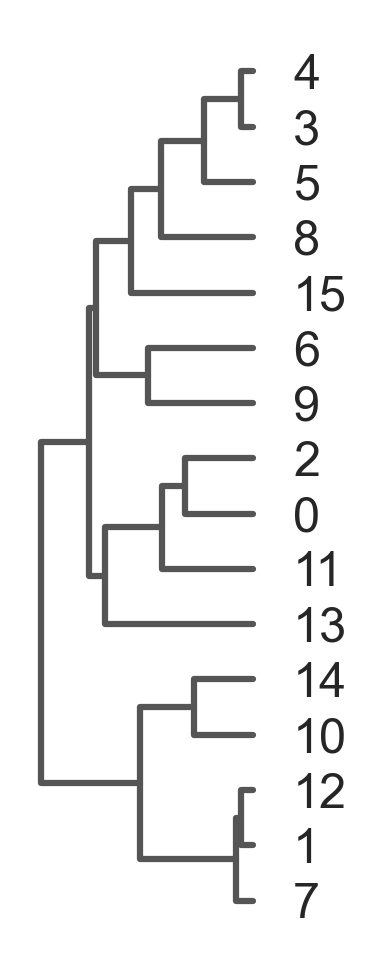

In [208]:
sc.tl.dendrogram(clones_pert_trunk, use_rep="word2vec", groupby="leiden_1", linkage_method="average")

fig, ax = plt.subplots(figsize=(1, 4))
sc.pl.dendrogram(clones_pert_trunk, groupby="leiden_1", orientation="left", ax=ax, show=False)

plt.savefig("figures/dendrogrampert_trunk.pdf", bbox_inches="tight")

<Axes: >

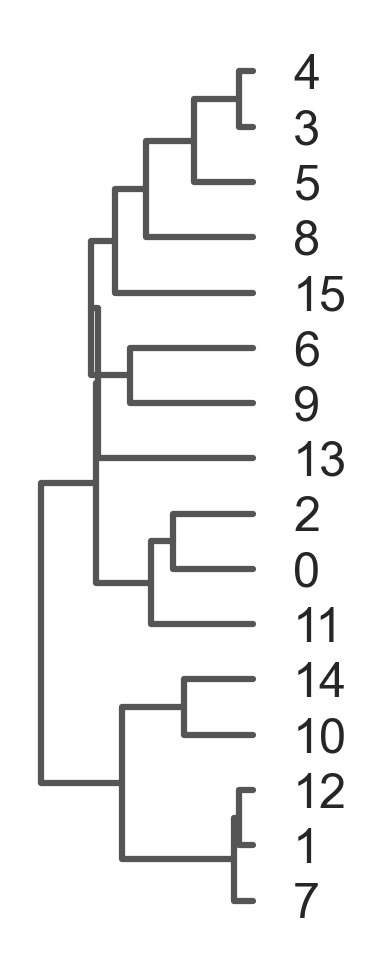

In [210]:
sc.tl.dendrogram(clones_pert_trunk, use_rep="word2vec", groupby="leiden_1", linkage_method="centroid")

fig, ax = plt.subplots(figsize=(1, 4))
sc.pl.dendrogram(clones_pert_trunk, groupby="leiden_1", orientation="left", ax=ax, show=False)

# plt.savefig("figures/dendrogrampert_trunk.pdf", bbox_inches="tight")

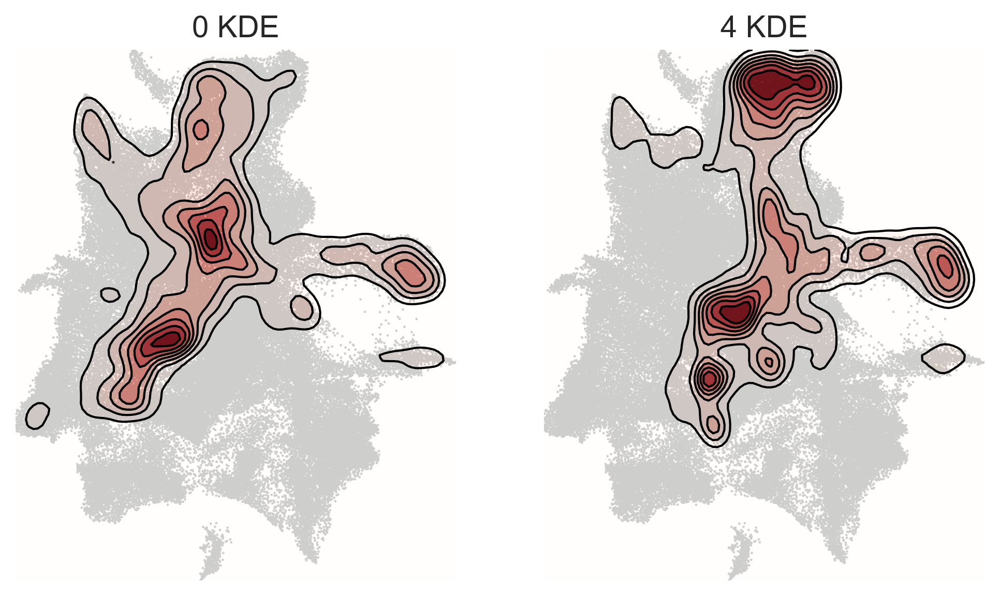

In [211]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4.5))

sl.pl.kde(mes_trunk, groupby="clones_clusters_1", group="0", ax=axes[0])
sl.pl.kde(mes_trunk, groupby="clones_clusters_1", group="4", ax=axes[1])

# plt.savefig("figures/KDE_Ptch1_mes_control.pdf", bbox_inches="tight")

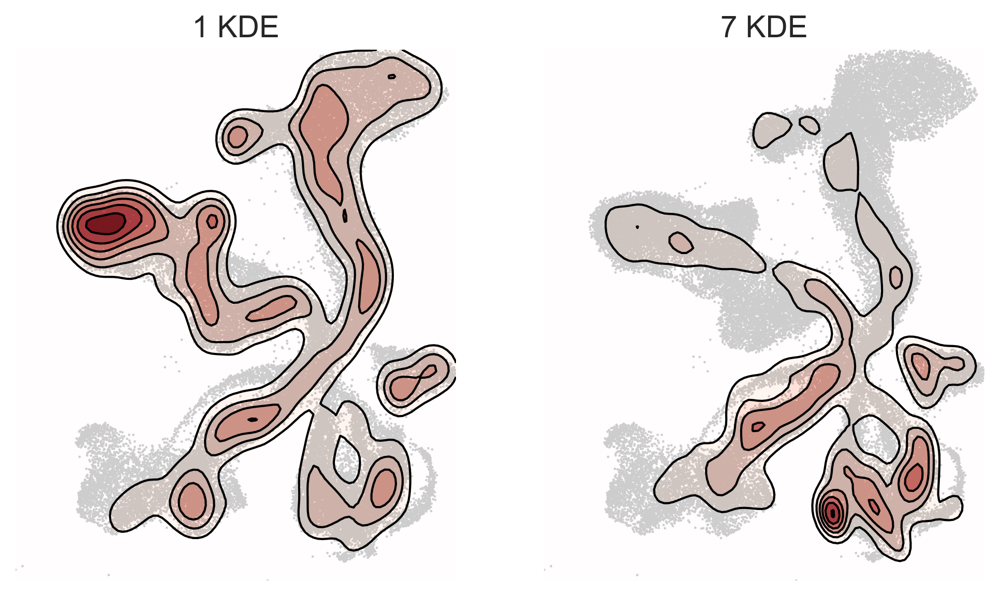

In [195]:
fig, axes = plt.subplots(ncols=2, figsize=(8, 4.5))

sl.pl.kde(neur_trunk, groupby="clones_clusters_1", group="1", ax=axes[0])
sl.pl.kde(neur_trunk, groupby="clones_clusters_1", group="7", ax=axes[1])

plt.savefig("figures/KDE_Ptch1_neur_control.pdf", bbox_inches="tight")

In [136]:
perturbation_colors = {
    "Acvr2a": "#a1b8d4",
    "Acvrl1": "#e68483",
    "Bmpr1a": "#8cc177",
    "Bmpr2": "#73473e",
    "EGFP-1": "#bb2727",
    "Fgfr1": "#266296",
    "Fzd2": "#2eaeb7",
    "Fzd4": "#6e4a87",
    "Hhip": "#b08a7f",
    "Lgr4": "#d1d37d",
    "Lrp2": "#b59fc0",
    "Lrp4": "#93cfd3",
    "Ptch1": "#f2ad6a",
    "Tgfbr3": "#eaa8bf",
    "multi_gRNA": "#e26b26",
    "uncertain": "#a4ad55",
    "NA": "#cccccc",
    "multiple": "#cccccc",
}

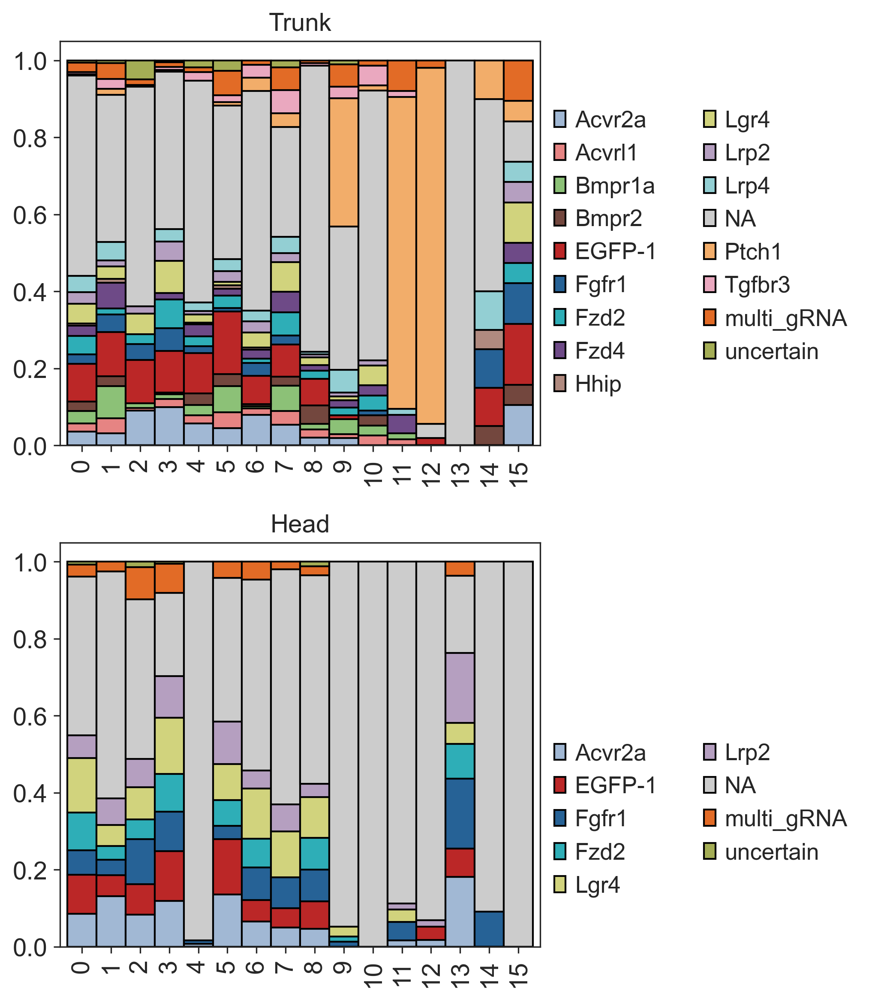

In [143]:
trunk_proportions = clones_pert_trunk.obs[["leiden_1", "perturbation"]].groupby(["leiden_1", "perturbation"]).size().unstack()
trunk_proportions = (trunk_proportions.T / trunk_proportions.sum(axis=1)).T

head_proportions = clones_pert_face.obs[["leiden_1", "perturbation"]].groupby(["leiden_1", "perturbation"]).size().unstack()
head_proportions = (head_proportions.T / head_proportions.sum(axis=1)).T

fig, axes = plt.subplots(nrows=2, figsize=(7, 8))
trunk_proportions.plot(kind="bar", stacked=True, ax=axes[0], edgecolor="black", width=1, color=perturbation_colors)
axes[0].legend(ncols=2, loc=(1.01, 0.1), edgecolor="white")
axes[0].set_xlabel("")
axes[0].set_title("Trunk")

head_proportions.plot(kind="bar", stacked=True, ax=axes[1], edgecolor="black", width=1, color=perturbation_colors)
axes[1].legend(ncols=2, loc=(1.01, 0.1), edgecolor="white")
axes[1].set_xlabel("")
axes[1].set_title("Head")

plt.tight_layout()

plt.savefig("figures/barplots_gRNA.pdf", bbox_inches="tight")

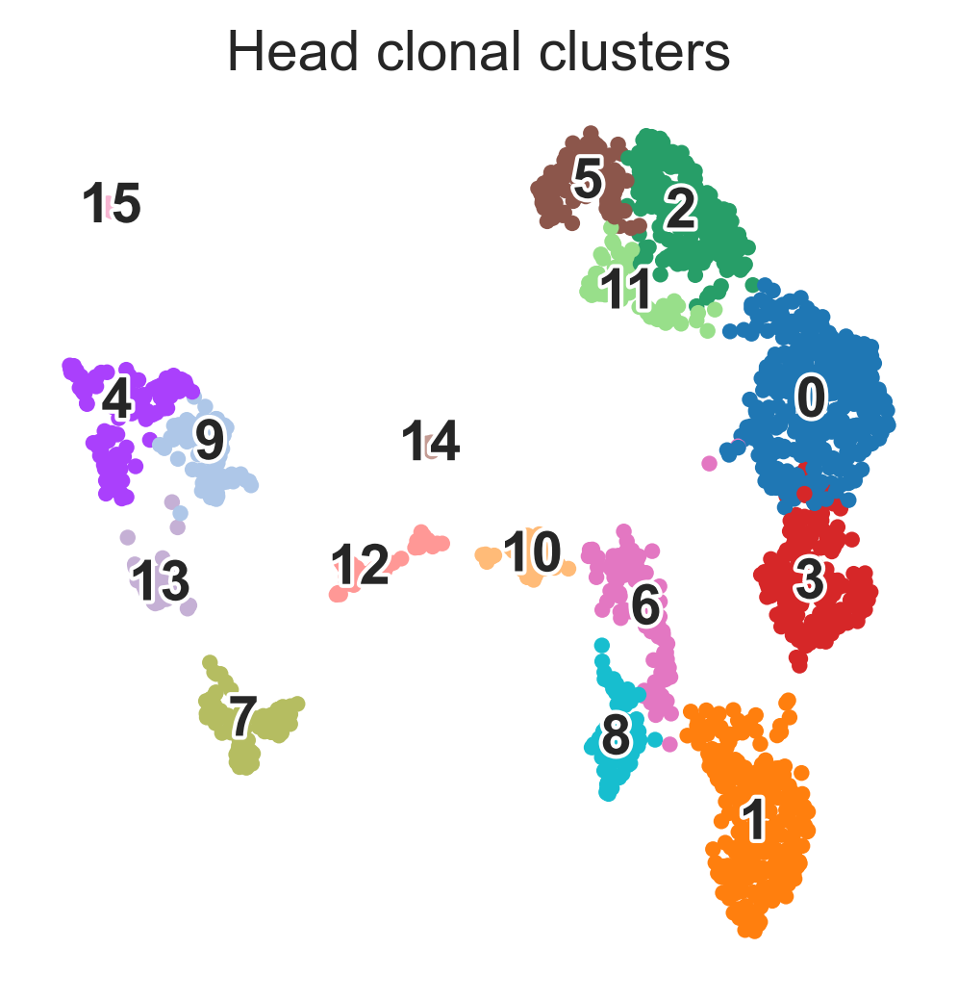

In [150]:
sc.pl.umap(clones_pert_face, color="leiden_1", legend_loc="on data", legend_fontoutline=2, frameon=False, title="Head clonal clusters", save="_head_clonal_clusters.pdf")

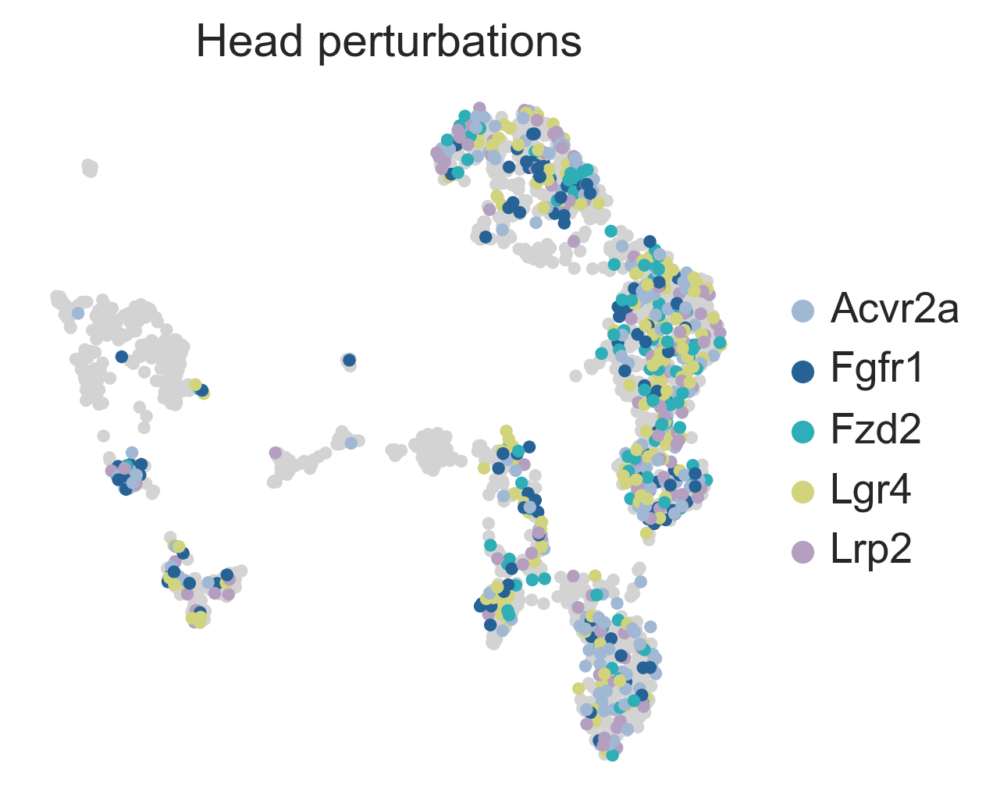

In [153]:
clones_pert_face.uns["perturbation_colors"] = [perturbation_colors[i] for i in clones_pert_face.obs.perturbation.cat.categories]
groups = [i for i in clones_pert_face.obs.perturbation.cat.categories if i not in ["EGFP-1", "NA", "multi_gRNA", "uncertain"]]

sc.pl.umap(clones_pert_face, color="perturbation", frameon=False, title="Head perturbations", save="_head_perturbations.pdf", groups=groups, na_in_legend=False)

In [ ]:
ct_order = [
    "Connective", "Fibroblasts", "Tongue mesenchyme", "Dermal fibroblast",
    "Dermal mesenchyme", "MSC", "Osteoblast", "Dental mesenchyme incisor",
    "Osteoprogenitor", "Mesenchyme Dlx Middle ", "Chondroblast", "Dental mesenchyme",
    "Chondrocyte", "Nasal mesenchyme", "Mesenchyme Sh3gl3", "Mesenchyme Dlx lower",
    "Mesenchyme Vav3", "Mesenchyme Tbx1", "Mesenchyme Side Thbs4 ",
    "Mesenchyme Progenitor Sox5", "Mesenchyme Hox", "Muscle", "Meningeal fibroblast",
    "Perivascular", "Periocular mesenchyme", "Neurod6", "Pou3f1", "Erbb4 Hoxb8",
    "CNS progenitors", "CNS Neuron", "CNS Glu", "Rax", "Retinal ganglion",
    "Sympathetic", "Glia", "Sensory A", "Melanocytes", "Epithelial cells",
    "Neuroepithelial", "Skin"
]

adata_clones_head.obs["leiden_2"] = adata_clones_head.obs["leiden_2"].cat.reorder_categories([
    "0", "5", "14", "1", "9", "15", "4", "3", "16", "8", "7", "10", "2", "11", "12", "17", "20", 
    "6", "19", "13", "18"
])

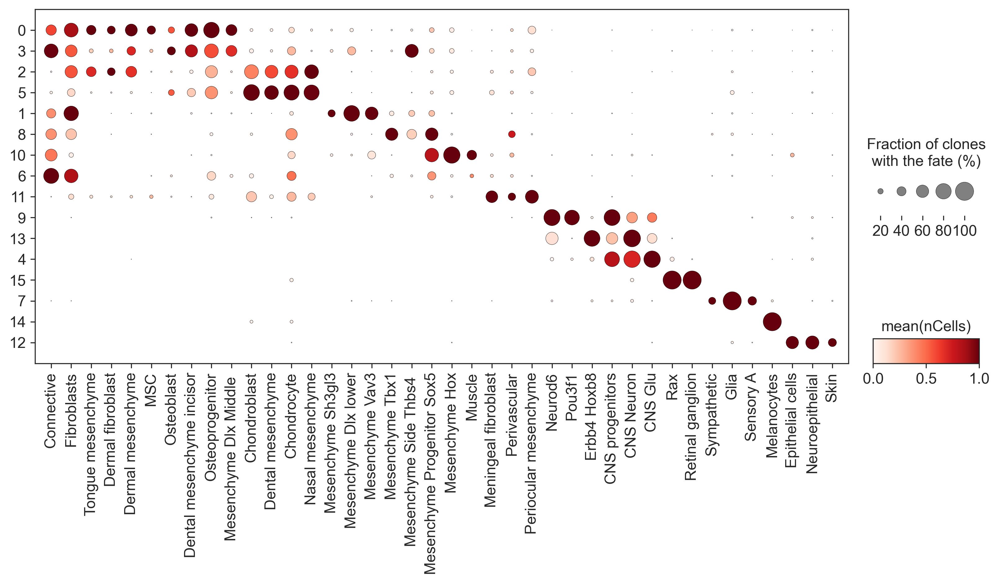

In [160]:
ct_order = [
    "Connective", "Fibroblasts", "Tongue mesenchyme", "Dermal fibroblast",
    "Dermal mesenchyme", "MSC", "Osteoblast", "Dental mesenchyme incisor",
    "Osteoprogenitor", "Mesenchyme Dlx Middle ", "Chondroblast", "Dental mesenchyme",
    "Chondrocyte", "Nasal mesenchyme", "Mesenchyme Sh3gl3", "Mesenchyme Dlx lower",
    "Mesenchyme Vav3", "Mesenchyme Tbx1", "Mesenchyme Side Thbs4 ",
    "Mesenchyme Progenitor Sox5", "Mesenchyme Hox", "Muscle", "Meningeal fibroblast",
    "Perivascular", "Periocular mesenchyme", "Neurod6", "Pou3f1", "Erbb4 Hoxb8",
    "CNS progenitors", "CNS Neuron", "CNS Glu", "Rax", "Retinal ganglion",
    "Sympathetic", "Glia", "Sensory A", "Melanocytes", "Epithelial cells",
    "Neuroepithelial", "Skin"
]

clones_pert_face.obs["leiden_1"] = clones_pert_face.obs["leiden_1"].cat.reorder_categories([
    "0", "3", "2", "5", "1", "8", "10", "6", "11", "9", "13", "4", "15", "7", "14", "12"
])

ax = sc.pl.dotplot(
    clones_pert_face,
    var_names=ct_order,
    groupby="leiden_1",
    cmap="Reds",
    dendrogram=False,
    figsize=(13, 5),
    standard_scale="var",
    show=True,
    colorbar_title="mean(nCells)",
    size_title="Fraction of clones\nwith the fate (%)",
    save="ct_compos_dotplot_face_perturbation.pdf"
)

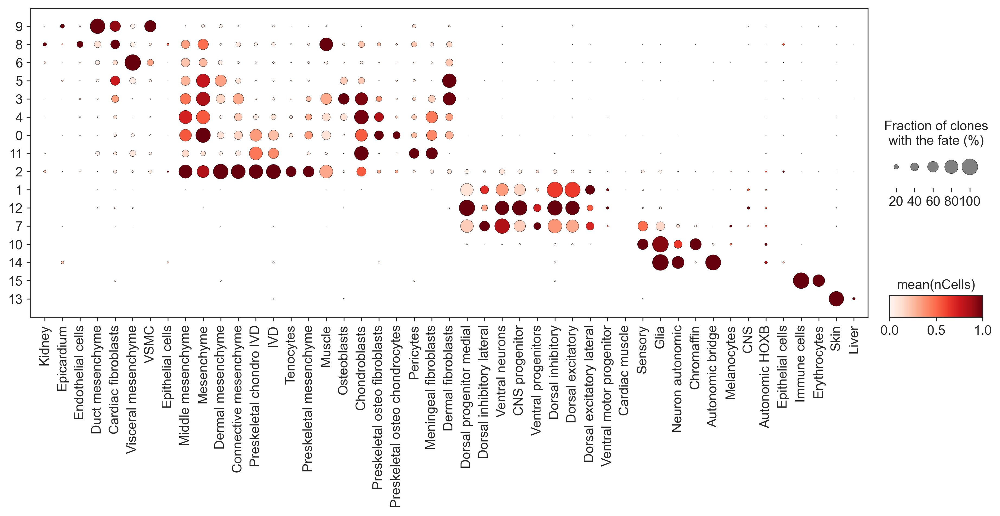

In [170]:
ct_order = [
    'Kidney', 'Epicardium', 'Endothelial cells', 'Duct mesenchyme',
    'Cardiac fibroblasts', 'Visceral mesenchyme', 'VSMC',
    'Epithelial cells', 'Middle mesenchyme', 'Mesenchyme', 'Dermal mesenchyme',
    'Connective mesenchyme', 'Preskeletal chondro IVD', 'IVD', 'Tenocytes',
    'Preskeletal mesenchyme', 'Muscle', 'Osteoblasts', 'Chondroblasts',
    'Preskeletal osteo fibroblasts', 'Preskeletal osteo chondrocytes',
    'Pericytes', 'Meningeal fibroblasts', 'Dermal fibroblasts',
    'Dorsal progenitor medial', 'Dorsal inhibitory lateral',
    'Ventral neurons', 'CNS progenitor', 'Ventral progenitors',
    'Dorsal inhibitory', 'Dorsal excitatory', 'Dorsal excitatory lateral',
    'Ventral motor progenitor', 
    'Cardiac muscle', 'Sensory', 'Glia', 'Neuron autonomic', 'Chromaffin',
    'Autonomic bridge', 'Melanocytes', 'CNS', 'Autonomic HOXB',
    'Epithelial cells', 'Immune cells', 'Erythrocytes', 'Skin', 'Liver'
]

clones_pert_trunk.obs["leiden_1"] = clones_pert_trunk.obs["leiden_1"].cat.reorder_categories([
    "9", "8", "6", "5", "3", "4", "0", "11", "2", "1", "12", "7", "10", "14", "15", "13"
])

ax = sc.pl.dotplot(
    clones_pert_trunk,
    var_names=ct_order,
    groupby="leiden_1",
    cmap="Reds",
    dendrogram=False,
    figsize=(15, 5),
    standard_scale="var",
    show=True,
    colorbar_title="mean(nCells)",
    size_title="Fraction of clones\nwith the fate (%)",
    save="ct_compos_dotplot_trunk_perturbation.pdf"
)

In [257]:
cns_progenitors = neur_trunk[neur_trunk.obs.celltype_l2 == "CNS progenitor"].copy()
cns_progenitors.obs["CRISPR:predicted"] = cns_progenitors.obs["CRISPR:predicted"].fillna("NA")
cns_progenitors.obs["CRISPR:predicted"] = ["multiple" if "|" in i else i for i in cns_progenitors.obs["CRISPR:predicted"]]
cns_progenitors = cns_progenitors[~cns_progenitors.obs["CRISPR:predicted"].isin(["NA", "multiple", "uncertain"])]
cns_progenitors.uns["log1p"] = {"base": None}

sc.tl.rank_genes_groups(cns_progenitors, groupby="CRISPR:predicted", reference="EGFP-1")

In [263]:
min_log2fc = 2.5
max_fdr = 1e-10

df = sc.get.rank_genes_groups_df(cns_progenitors, group="Ptch1")
df = df[(np.abs(df.logfoldchanges) >= min_log2fc) & (df.pvals_adj <= max_fdr)]

In [264]:
df[df.logfoldchanges > 0]

,names,scores,logfoldchanges,pvals,pvals_adj
0,Hhip,22.385593,3.886069,7.315846e-81,2.429373e-76
1,Igfbpl1,17.281666,3.750496,3.223260e-54,5.351739e-50
3,Fgf15,14.389884,2.712859,5.261698e-39,4.368130e-35
4,Tec,12.984283,3.151250,2.529828e-34,1.200114e-30
14,Ptch2,9.373421,3.179261,1.164758e-19,2.035691e-16
28,Col22a1,7.792909,2.893842,2.619441e-14,1.425963e-11


In [265]:
df[df.logfoldchanges < 0]

,names,scores,logfoldchanges,pvals,pvals_adj
33179,Fndc5,-8.468729,-2.682350,6.697988e-15,4.118891e-12
33181,Hoxa10,-8.510694,-2.588777,4.648337e-15,3.087146e-12
33189,Sema6a,-8.966802,-2.531451,2.610945e-16,2.064325e-13
33191,Glra1,-9.037461,-3.265379,2.403072e-16,1.962974e-13
33192,Gm12239,-9.050209,-3.559261,2.377172e-16,1.962974e-13
33195,Slitrk2,-9.345891,-2.683470,2.388361e-17,2.832511e-14
33202,Ppp2r2b,-12.469788,-3.316093,1.766018e-26,5.331286e-23


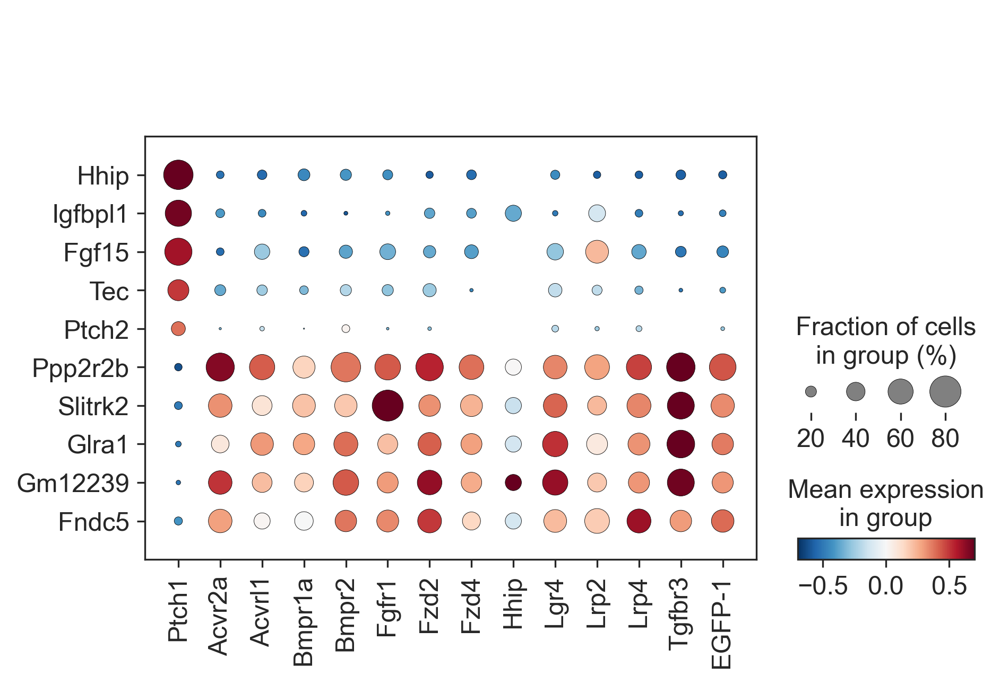

In [271]:
genes = ["Hhip", "Igfbpl1", "Fgf15", "Tec", "Ptch2", "Ppp2r2b", "Slitrk2", "Glra1", "Gm12239", "Fndc5"]

adata_draw = cns_progenitors[:, genes].copy()
sc.pp.scale(adata_draw, max_value=10)
adata_draw.obs["CRISPR:predicted"] = adata_draw.obs["CRISPR:predicted"].cat.reorder_categories([
    "Ptch1", "Acvr2a", "Acvrl1", "Bmpr1a", "Bmpr2", "Fgfr1",
    "Fzd2", "Fzd4", "Hhip", "Lgr4", "Lrp2", "Lrp4", "Tgfbr3",
    "EGFP-1",
])

sc.pl.dotplot(
    adata_draw,
    var_names=genes,
    groupby="CRISPR:predicted",
    vmin=-0.7,
    vmax=0.7,
    cmap="RdBu_r",
    swap_axes=True,
    save="Ptch1_markers.pdf",
)